In [1]:
# from google.colab import drive
# drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# !unzip '/content/drive/MyDrive/dataset/images.zip' -d '/content/drive/MyDrive/ObjectDetection2/master-data-2/masterdata2'

# Spliting data into train and val sets

In [17]:
import os
from random import choice
import shutil

#arrays to store file names
imgs =[]
xmls =[]

#setup dir names
# trainPath = '/content/drive/MyDrive/mini2/newdata/train'
# valPath = '/content/drive/MyDrive/mini2/newdata/valid'
crsPath = '/content/drive/MyDrive/ObjectDetection2/master-data-2/imageslbl' #dir where images and annotations stored

#setup ratio (val ratio = rest of the files in origin dir after splitting into train and test)
train_ratio = 0.80
val_ratio = 0.20


#total count of imgs
totalImgCount = len(os.listdir(crsPath))/2

#storing files to corresponding arrays
for (dirname, dirs, files) in os.walk(crsPath):
    for filename in files:
        if filename.endswith('.txt'):
            xmls.append(filename)
        else:
            imgs.append(filename)


#counting range for cycles
countForTrain = int(len(imgs)*train_ratio)
countForVal = int(len(imgs)*val_ratio)
print("training images are : ",countForTrain)
print("Validation images are : ",countForVal)

training images are :  1004
Validation images are :  251


In [18]:
trainImagePath = '/content/drive/MyDrive/ObjectDetection2/master-data-2/train/images'
trainLabelPath = '/content/drive/MyDrive/ObjectDetection2/master-data-2/train/labels'
valImagePath = '/content/drive/MyDrive/ObjectDetection2/master-data-2/val/images'
valLabelPath = '/content/drive/MyDrive/ObjectDetection2/master-data-2/val/labels'

#cycle for train dir
for x in range(countForTrain):
    fileJpg = choice(imgs) # get name of random image from origin dir
    fileXml = fileJpg[:-4] +'.txt' # get name of corresponding annotation file

    #move both files into train dir
    #shutil.move(os.path.join(crsPath, fileJpg), os.path.join(trainImagePath, fileJpg))
    #shutil.move(os.path.join(crsPath, fileXml), os.path.join(trainLabelPath, fileXml))
    shutil.copy(os.path.join(crsPath, fileJpg), os.path.join(trainImagePath, fileJpg))
    shutil.copy(os.path.join(crsPath, fileXml), os.path.join(trainLabelPath, fileXml))


    #remove files from arrays
    # imgs.remove(fileJpg)
    # xmls.remove(fileXml)


#cycle for val dir   
for x in range(countForVal):
    fileJpg = choice(imgs) # get name of random image from origin dir
    fileXml = fileJpg[:-4] +'.txt' # get name of corresponding annotation file

    #move both files into train dir
    #shutil.move(os.path.join(crsPath, fileJpg), os.path.join(valimagePath, fileJpg))
    #shutil.move(os.path.join(crsPath, fileXml), os.path.join(vallabelPath, fileXml))
    shutil.copy(os.path.join(crsPath, fileJpg), os.path.join(valImagePath, fileJpg))
    shutil.copy(os.path.join(crsPath, fileXml), os.path.join(valLabelPath, fileXml))
    
    #remove files from arrays
    imgs.remove(fileJpg)
    xmls.remove(fileXml)

In [26]:
%cd '/content/drive/MyDrive/ObjectDetection2'

/content/drive/MyDrive/ObjectDetection2


In [ ]:
!git clone https://github.com/ultralytics/yolov5.git

In [27]:
%cd yolov5

/content/drive/MyDrive/ObjectDetection2/yolov5


In [ ]:
!pip install -r requirements.txt

# Training the model

## Training Trial

In [33]:
!python train.py --img 640 --batch 16 --epochs 6 --data master-data-2.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=master-data-2.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=6, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 5 commits. Use 'git pull' or 'git clone https://github.com/ultralytics/yolov5' to update.
YOLOv5 🚀 v7.0-115-g5ca8e82 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0

In [34]:
import torch
from IPython.display import Image, clear_output 

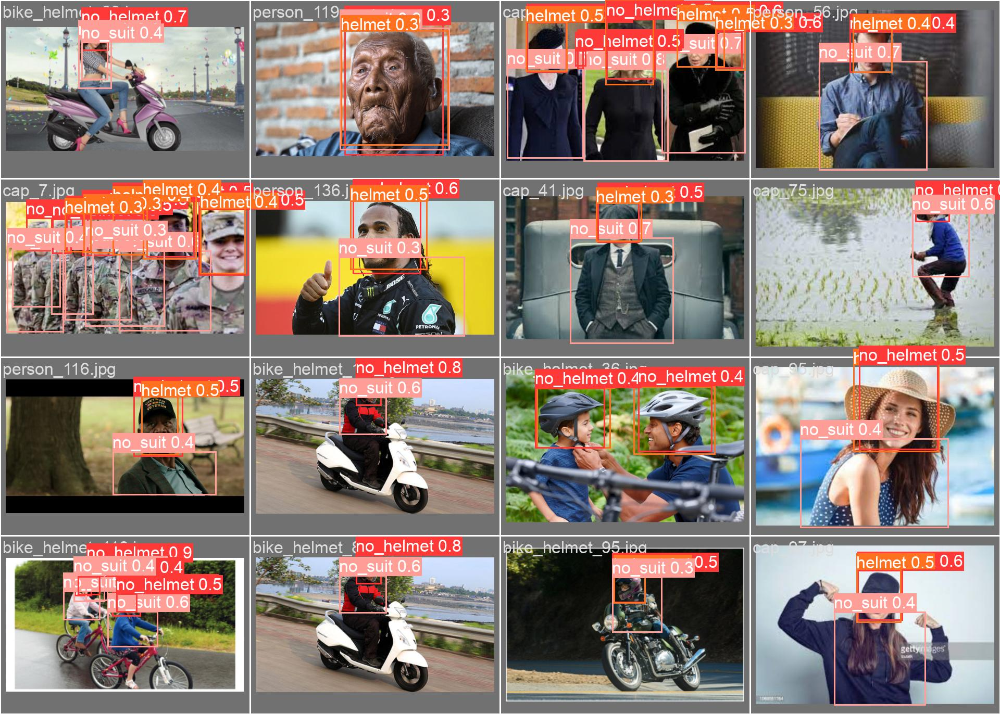

In [35]:
Image(filename='/content/drive/MyDrive/ObjectDetection2/yolov5/runs/train/exp2/val_batch0_pred.jpg', width=1000)

## Training on 30 epochs

In [36]:
!python train.py --img 640 --batch 16 --epochs 30 --data master-data-2.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=master-data-2.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=30, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 5 commits. Use 'git pull' or 'git clone https://github.com/ultralytics/yolov5' to update.
YOLOv5 🚀 v7.0-115-g5ca8e82 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=

# Detection results

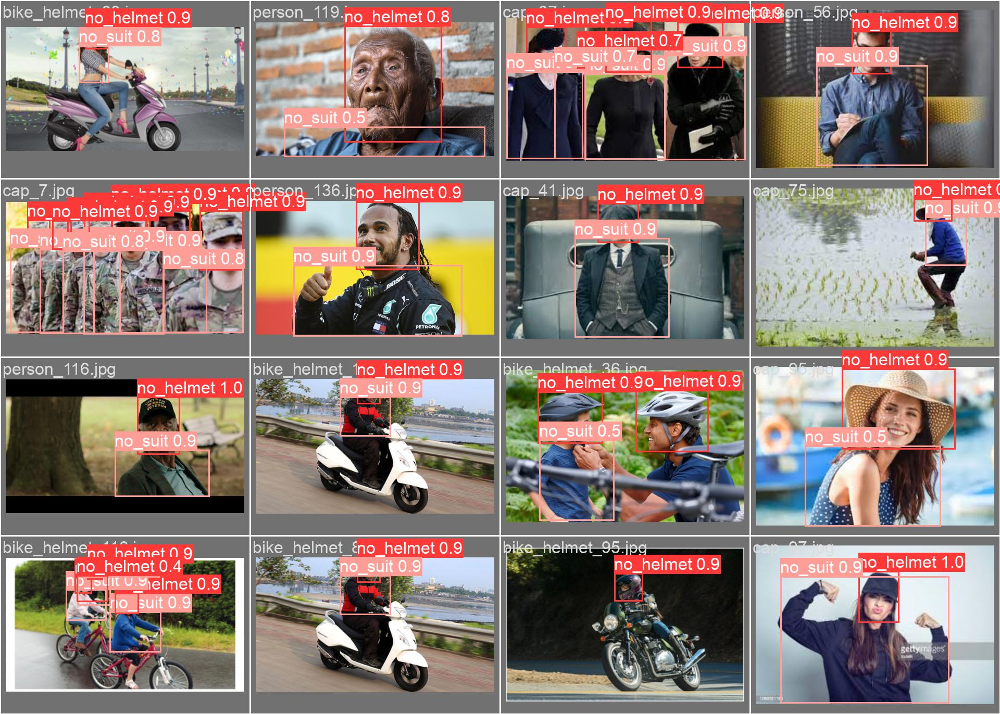

In [37]:
Image(filename='/content/drive/MyDrive/ObjectDetection2/yolov5/runs/train/exp3/val_batch0_pred.jpg', width=1000)

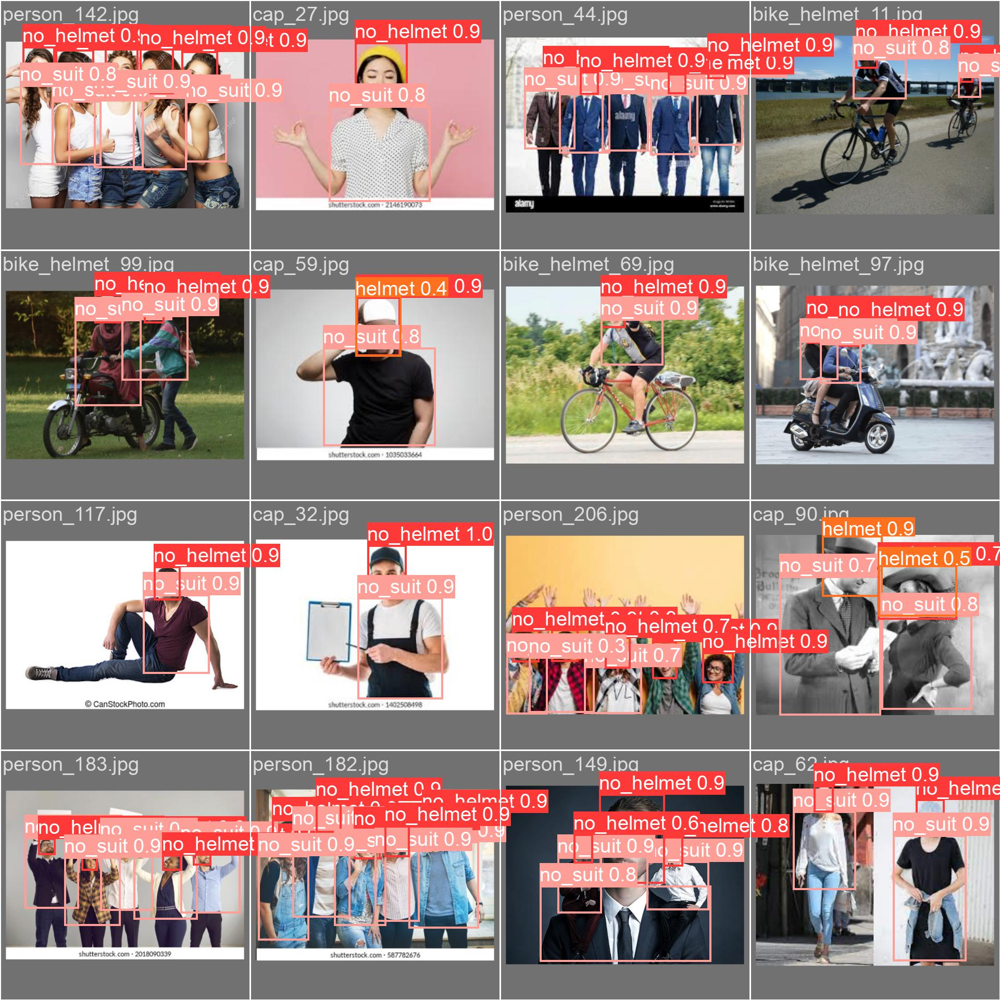

In [38]:
Image(filename='/content/drive/MyDrive/ObjectDetection2/yolov5/runs/train/exp3/val_batch1_pred.jpg', width=1000)

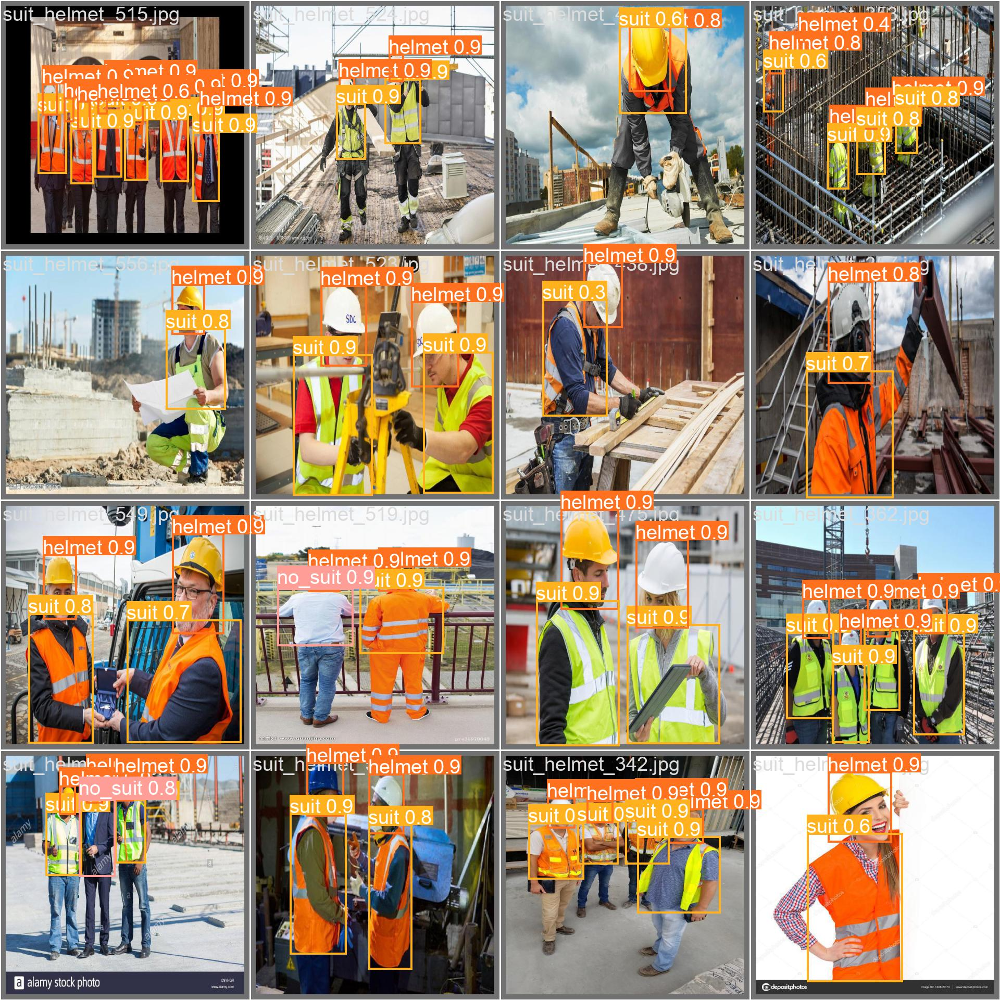

In [39]:
Image(filename='/content/drive/MyDrive/ObjectDetection2/yolov5/runs/train/exp3/val_batch2_pred.jpg', width=1000)

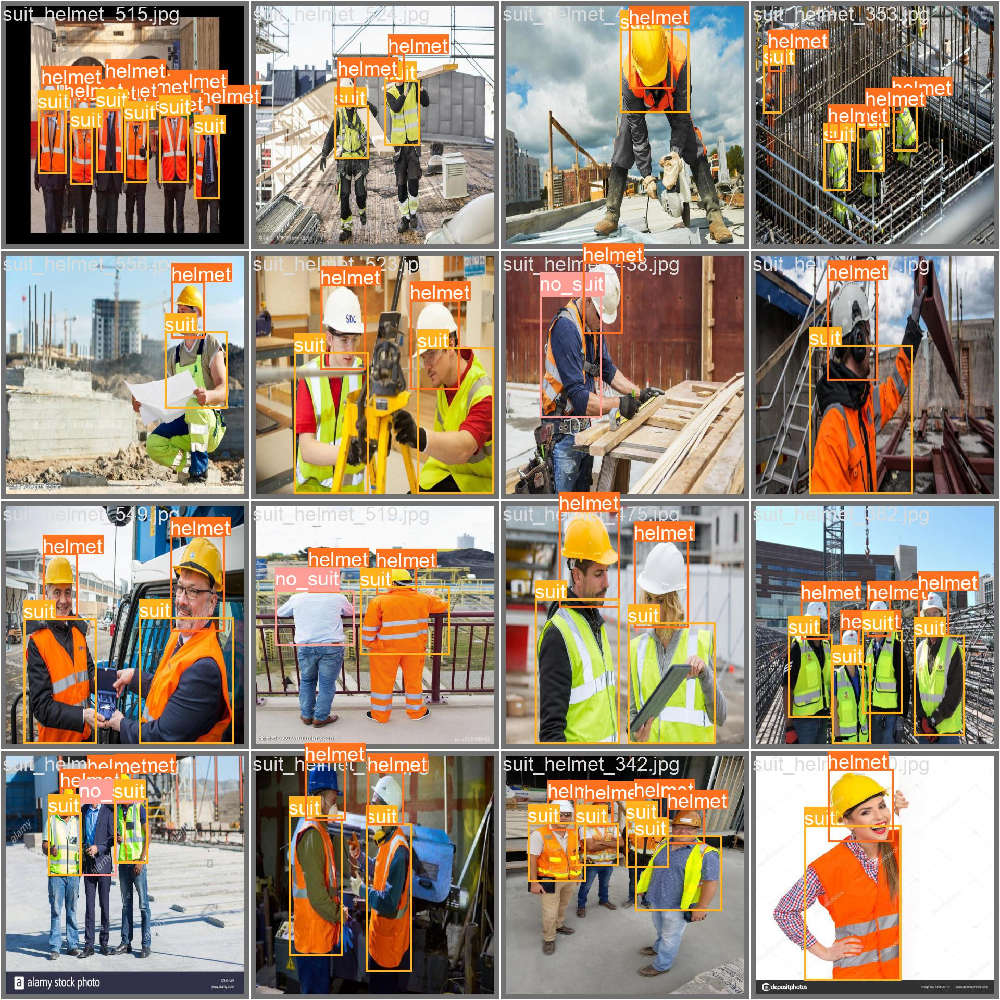

In [40]:
Image(filename='/content/drive/MyDrive/ObjectDetection2/yolov5/runs/train/exp3/val_batch2_labels.jpg', width=1000)

In [42]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

# Testing model on random images

In [43]:
pwd

'/content/drive/MyDrive/ObjectDetection2/yolov5'

In [47]:
!python detect.py --weights runs/train/exp3/weights/best.pt --img 416 --conf 0.3 --source ../test-img

detect: weights=['runs/train/exp3/weights/best.pt'], source=../test-img, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.3, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-115-g5ca8e82 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7020913 parameters, 0 gradients, 15.8 GFLOPs
image 1/31 /content/drive/MyDrive/ObjectDetection2/test-img/061026-F-6882G-0001.JPG: 288x416 1 no_helmet, 2 helmets, 1 suit, 14.5ms
image 2/31 /content/drive/MyDrive/ObjectDetection2/test-img/080707-F-6278H-011.JPG: 288x416 2 no_helmets, 1 helmet, 1 suit, 15.1ms
image 3/31 /content/drive/MyDrive/ObjectDetection2/test-img/120712-F-EJ686-078.JPG: 288x416

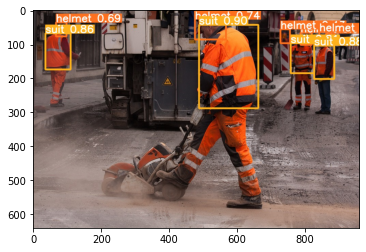

In [65]:
from PIL import Image
import numpy as np
import os
import random
import matplotlib.pyplot as plt
%matplotlib inline 
detections_dir = "/content/drive/MyDrive/ObjectDetection2/yolov5/runs/detect/exp/"
detection_images = [os.path.join(detections_dir, x) for x in os.listdir(detections_dir)]

random_detection_image = Image.open(random.choice(detection_images))
plt.imshow(np.array(random_detection_image));

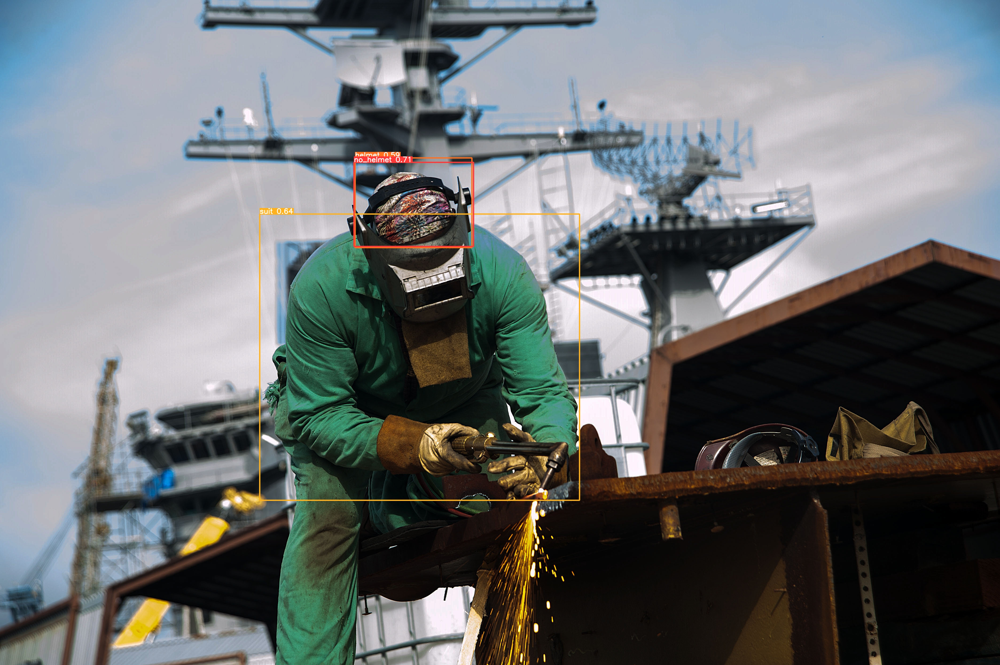

In [ ]:
#display inference on ALL test images
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/drive/MyDrive/ObjectDetection2/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Training after applying augmentation

In [1]:
%cd '/content/drive/MyDrive/ObjectDetection2/yolov5'

/content/drive/MyDrive/ObjectDetection2/yolov5


In [7]:
# !rm -rf '/content/drive/MyDrive/ObjectDetection2/yolov5/runs/train/exp4'

In [8]:
!python train.py --img 640 --batch 16 --epochs 60 --data master-data-2.yaml --hyp data/hyps/hyp.custom.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=master-data-2.yaml, hyp=data/hyps/hyp.custom.yaml, epochs=60, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 5 commits. Use 'git pull' or 'git clone https://github.com/ultralytics/yolov5' to update.
YOLOv5 🚀 v7.0-115-g5ca8e82 Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.00334, lrf=0.15135, momentum=0.74832, weight_decay=0.00025, warmup_epochs=3.3835, warmup_momentum=0.59462, warmup_bias_lr=0.18657, box=0.02, cls=0.21638, cls_pw=0.5, obj=0.51

## Training on yolov5m.pt with hyp.custom2.yaml

In [2]:
!python train.py --img 640 --batch 16 --epochs 60 --data master-data-2.yaml --hyp data/hyps/hyp.custom2.yaml --weights yolov5m.pt --cache

requirements: YOLOv5 requirement "gitpython" not found, attempting AutoUpdate...
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 KB 5.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 KB 10.1 MB/s eta 0:00:00

requirements: 1 package updated per ['gitpython']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect

train: weights=yolov5m.pt, cfg=, data=master-data-2.yaml, hyp=data/hyps/hyp.custom2.yaml, epochs=60, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, up

In [2]:
!python train.py --img 640 --batch 16 --epochs 160 --data master-data-2.yaml --hyp data/hyps/hyp.custom3.yaml --weights yolov5s.pt --cache

requirements: YOLOv5 requirement "gitpython" not found, attempting AutoUpdate...
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 KB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 KB 9.3 MB/s eta 0:00:00

requirements: 1 package updated per ['gitpython']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect

train: weights=yolov5s.pt, cfg=, data=master-data-2.yaml, hyp=data/hyps/hyp.custom3.yaml, epochs=160, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, up